<a href="https://colab.research.google.com/github/shreyasrajesh0308/ECE188DeepLearning/blob/main/Adv_example_Task2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Perform an Adversarial attack.

For the second part of the project we consider a trained model (MobileNet) which is trained on the imagenet dataset. 

We use an evasion attack called [FGSM](https://neptune.ai/blog/adversarial-attacks-on-neural-networks-exploring-the-fast-gradient-sign-method#:~:text=The%20Fast%20Gradient%20Sign%20Method%20(FGSM)%20combines%20a%20white%20box,model%20into%20making%20wrong%20predictions.) to fool the neural network into making incorrect predictions.

## Import Packages.

Import the necessary packages we continue to use Tensorflow and Keras

In [2]:
import tensorflow as tf
import matplotlib as mpl
import matplotlib.pyplot as plt
from keras.preprocessing import image

mpl.rcParams['figure.figsize'] = (8, 8)
mpl.rcParams['axes.grid'] = False

## Load the Pretrained model. 

We use the [MobileNetV2](https://arxiv.org/abs/1801.04381) model trained on the [Imagenet](https://www.image-net.org/) dataset. 

In [3]:
pretrained_model = tf.keras.applications.MobileNetV2(include_top=True,
                                                     weights='imagenet')
pretrained_model.trainable = False

# ImageNet labels
decode_predictions = tf.keras.applications.mobilenet_v2.decode_predictions

14548992/14536120 [==============================] - 0s 0us/step


### Helper Function for Data Processing


Following functions can be used for data processing. Dont worry about these, just use them. 

In [4]:
# Helper function to preprocess the image so that it can be inputted in MobileNetV2
def preprocess(image):
  image = tf.cast(image, tf.float32)
  image = tf.image.resize(image, (224, 224))
  image = tf.keras.applications.mobilenet_v2.preprocess_input(image)
  image = image[None, ...]
  return image

# Helper function to extract labels from probability vector
def get_imagenet_label(probs):
  return decode_predictions(probs, top=1)[0][0]

## Load an Image. 


Load any image, we consider an image of a Panda. 

In [7]:
image_raw = tf.io.read_file('content/panda.jpg')
image = tf.image.decode_image(image_raw)

image = preprocess(image)
image_probs = pretrained_model.predict(image)

49152/35363 [=========================================] - 0s 0us/step


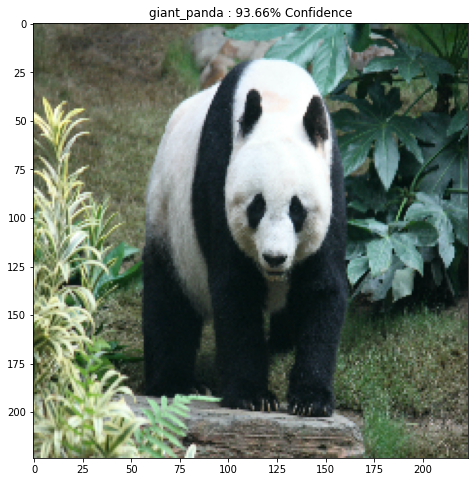

In [8]:
plt.figure()
plt.imshow(image[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]
_, image_class, class_confidence = get_imagenet_label(image_probs)
plt.title('{} : {:.2f}% Confidence'.format(image_class, class_confidence*100))
plt.show()

## Create the Adversarial Image. 

We use the FGSM method to create an adversarial image. Be sure to read about FGSM to understand how the attack works. 

In [9]:
loss_object = tf.keras.losses.CategoricalCrossentropy()

def create_adversarial_pattern(input_image, input_label):
  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = pretrained_model(input_image)
    loss = loss_object(input_label, prediction)

  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

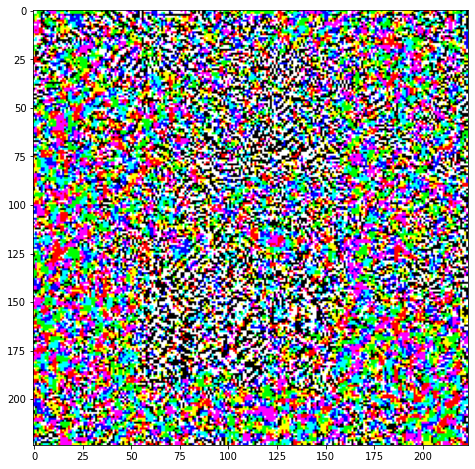

In [10]:
# Get the input label of the image.
giant_panda_index = 388
label = tf.one_hot(giant_panda_index, image_probs.shape[-1])
label = tf.reshape(label, (1, image_probs.shape[-1]))

perturbations = create_adversarial_pattern(image, label)
plt.imshow(perturbations[0] * 0.5 + 0.5);  # To change [-1, 1] to [0,1]

In [11]:
def display_images(image, description):
  _, label, confidence = get_imagenet_label(pretrained_model.predict(image))
  plt.figure()
  plt.imshow(image[0]*0.5+0.5)
  plt.title('{} \n {} : {:.2f}% Confidence'.format(description,
                                                   label, confidence*100))
  plt.show()

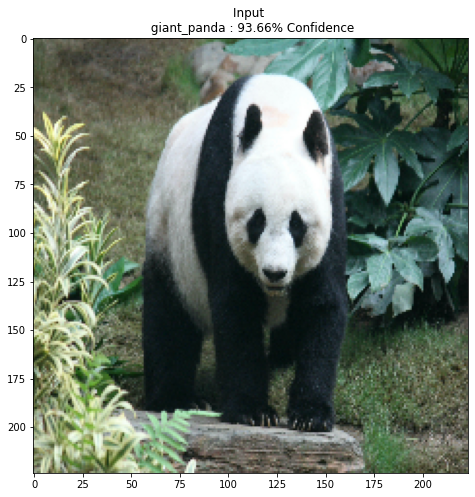

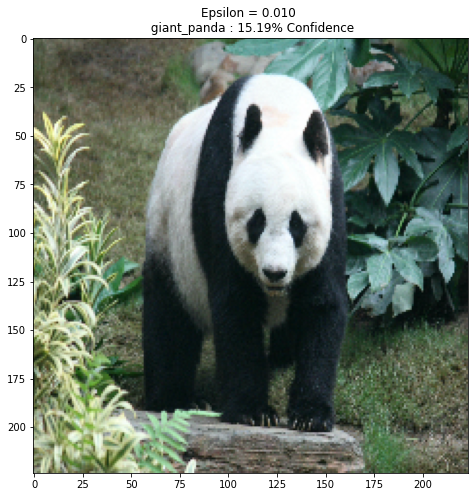

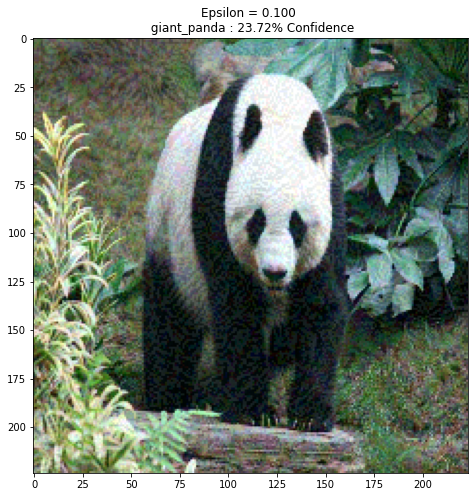

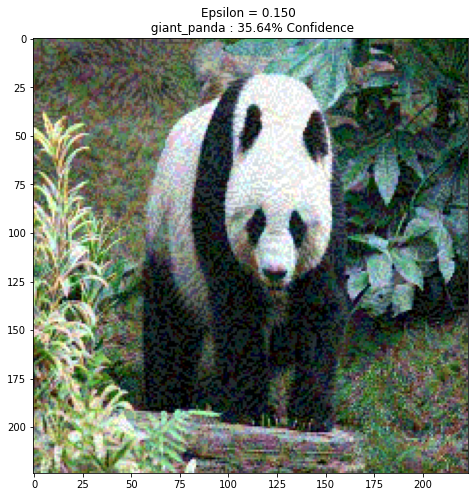

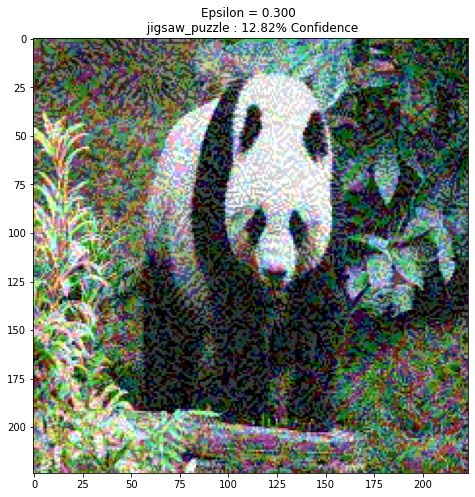

In [13]:
epsilons = [0, 0.01, 0.1, 0.15, 0.3]
descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                for eps in epsilons]

for i, eps in enumerate(epsilons):
  adv_x = image + eps*perturbations
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  display_images(adv_x, descriptions[i])

# Task2: Perform an Analysis to understand the potency of the attack. 

Your task here is to understand how small a change could change the class output and this is measured by the epsilon value needed to change the class. 

Your task is as follows:

* Pick 10 images each from different classes in imagenet. 
* Perform a perturbation analysis on each of these images. 
* In the analysis you are required to report the smallest epsilon value for which you notice a class change. 
* Make a table for each of the images considered with the minimum epsilon value for the FGSM attack. 

Write the Code for the above below. You can add the table also below. 

10 Imagenet classes chosen
- Goldfinch 11
- Boa Constrictor 61
- Scorpion 71
- Pizza 963
- Buckle 464
- Digital clock 530
- Dutch oven 544
- Scabbard 777
- Wooden Spoon 910
- Geyser 974

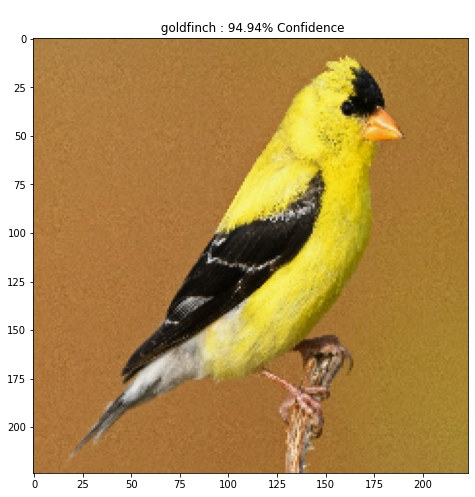

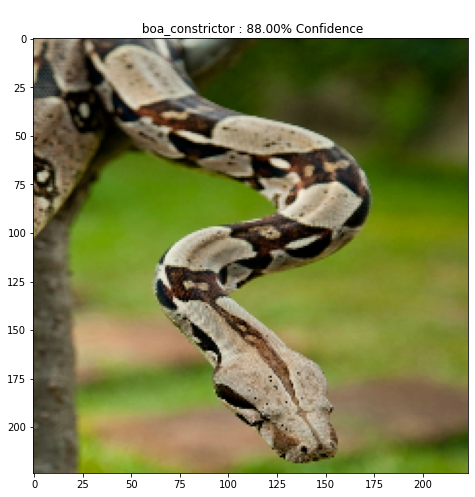

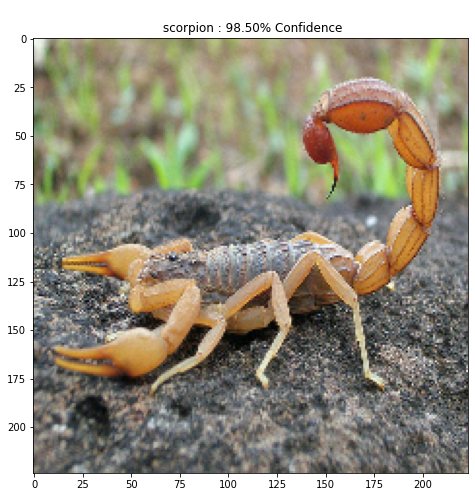

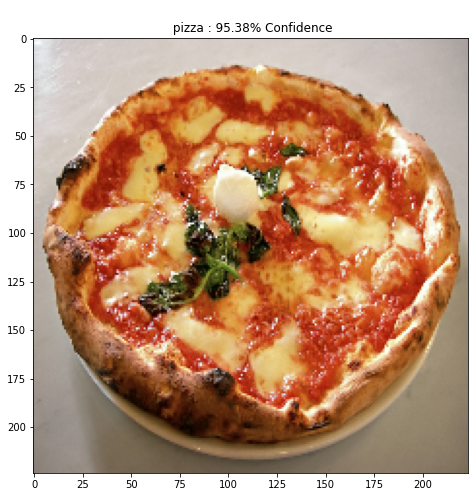

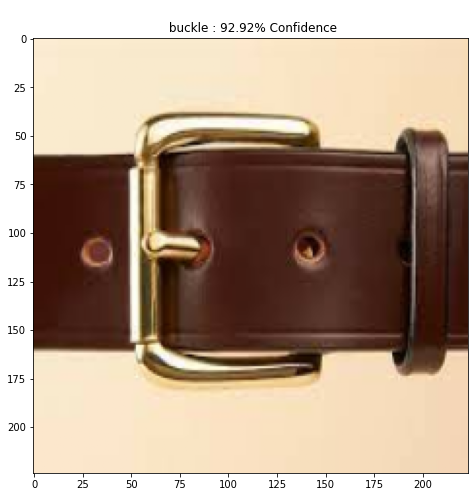

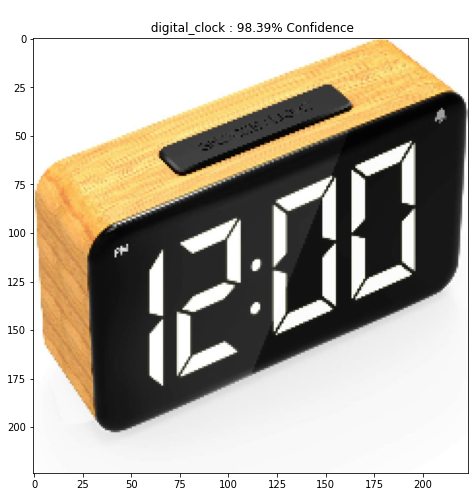

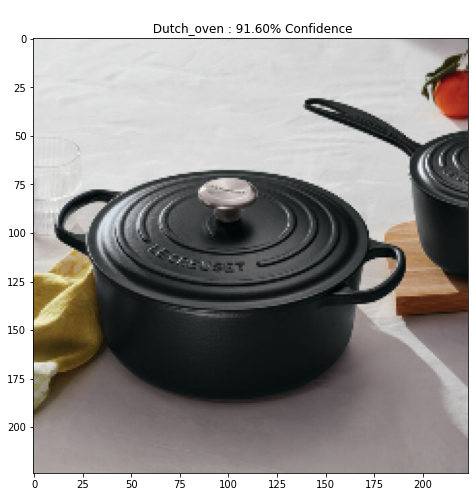

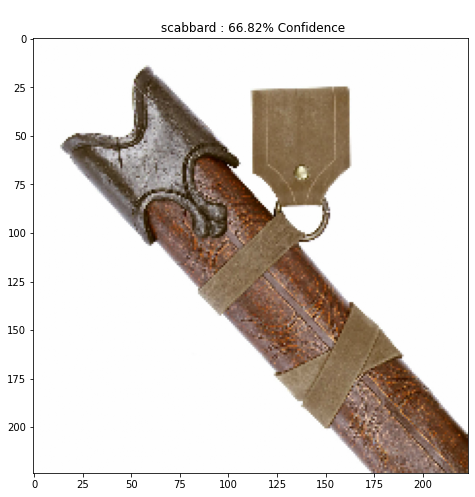

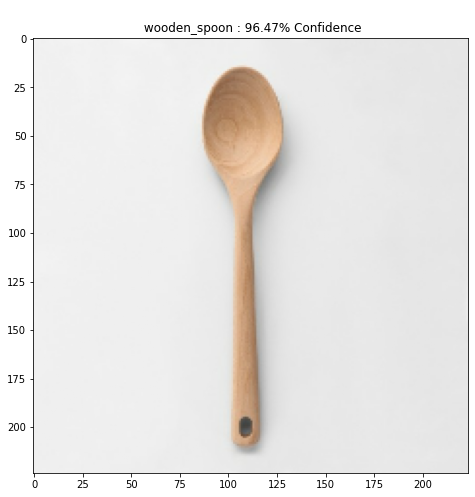

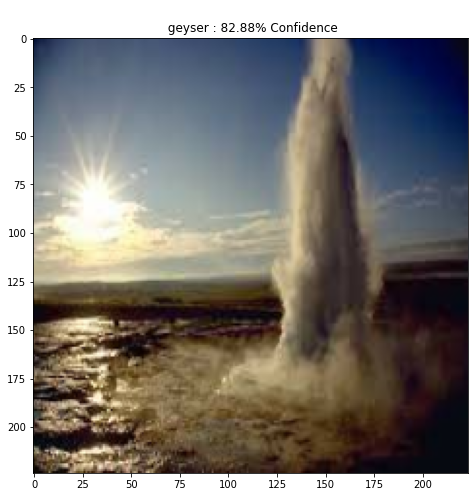

In [14]:
# Get Images
chosen_images = []
chosen_images_probs = []
chosen_indexes = [11, 61, 71, 963, 464, 530, 544, 777, 910, 974]
for i in range(0, 10):
 image_raw = tf.io.read_file('image'+ str(i) + '.jpg')
 image = tf.image.decode_image(image_raw)
 image = preprocess(image)
 chosen_images.append(image)
 image_probs = pretrained_model.predict(image)
 chosen_images_probs.append(image_probs)

 display_images(image, "")

In [15]:
chosen_perturbations = []

for i in range(0, 10):
 label = tf.one_hot(chosen_indexes[i], chosen_images_probs[i].shape[-1])
 label = tf.reshape(label, (1, chosen_images_probs[i].shape[-1]))

 perturbations = create_adversarial_pattern(chosen_images[i], label)
# plt.imshow(perturbations[0] * 0.5 + 0.5); # To change [-1, 1] to [0,1
 chosen_perturbations.append(perturbations)

In [24]:
def get_epsilon_and_display(image, pert, actual_label):
  eps = 0
  adv_x = image + eps*pert
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  _, label, confidence = get_imagenet_label(pretrained_model.predict(adv_x))
  while label == actual_label:
    eps = eps + 0.01
    adv_x = image + eps*pert
    adv_x = tf.clip_by_value(adv_x, -1, 1)
    _, label, confidence = get_imagenet_label(pretrained_model.predict(adv_x))
  # print(eps)
  # print(label)
  # print(actual_label)
  plt.figure()
  plt.imshow(adv_x[0]*0.5+0.5)
  plt.title('Epsilon = {:0.3f}\n{} : {:.2f}% Confidence'.format(eps, label, confidence*100))
  plt.show()
  return eps

In [27]:
import numpy as np
# epsilons = np.arange(0, 1, 0.01)
# descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
#  for eps in epsilons]
im_labels = [
"goldfinch",
"boa_constrictor",
"scorpion",
"pizza",
"buckle",
"digital_clock",
"Dutch_oven",
"scabbard",
"wooden_spoon",
"geyser"
]

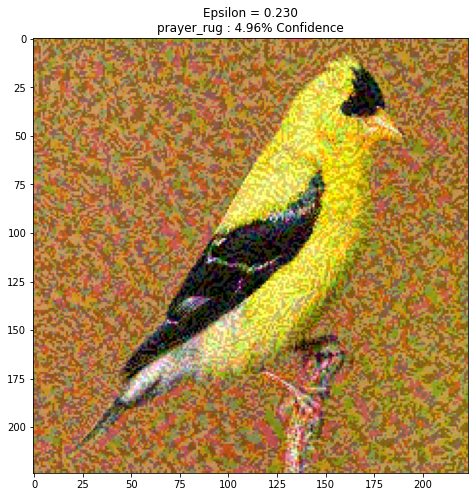

0.23000000000000007

In [28]:
get_epsilon_and_display(chosen_images[0], chosen_perturbations[0], im_labels[0])

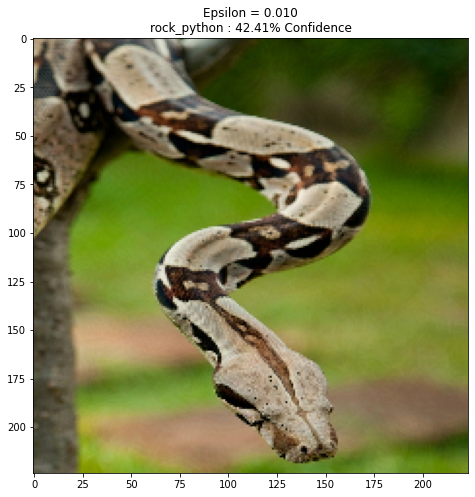

0.01

In [29]:
get_epsilon_and_display(chosen_images[1], chosen_perturbations[1], im_labels[1])

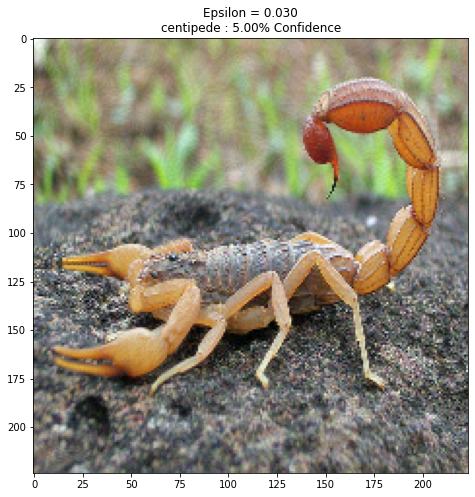

0.03

In [30]:
get_epsilon_and_display(chosen_images[2], chosen_perturbations[2], im_labels[2])

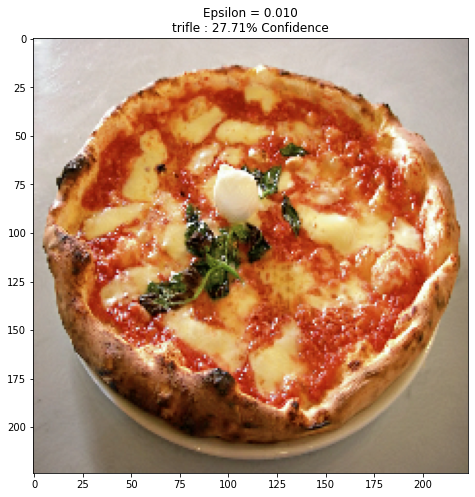

0.01

In [31]:
get_epsilon_and_display(chosen_images[3], chosen_perturbations[3], im_labels[3])

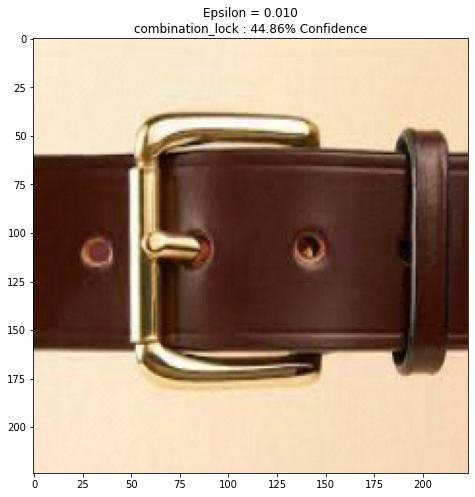

0.01

In [32]:
get_epsilon_and_display(chosen_images[4], chosen_perturbations[4], im_labels[4])

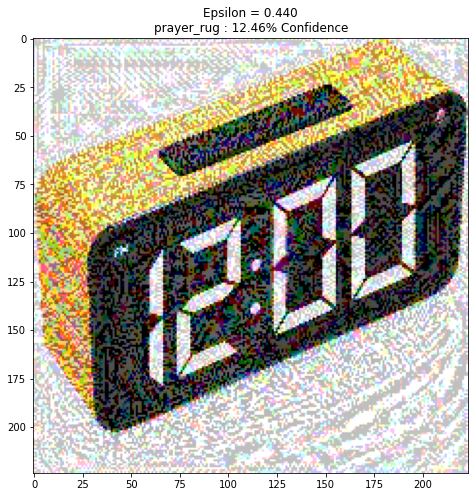

0.4400000000000002

In [33]:
get_epsilon_and_display(chosen_images[5], chosen_perturbations[5], im_labels[5])

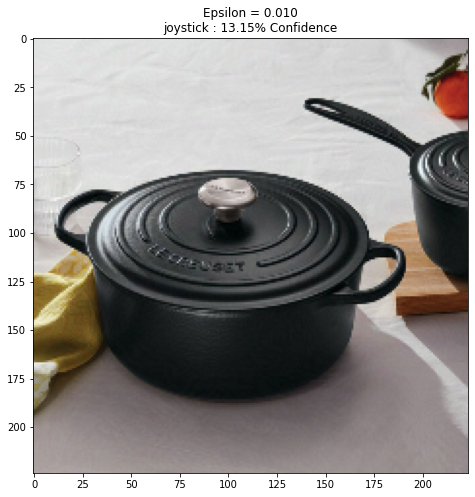

0.01

In [34]:
get_epsilon_and_display(chosen_images[6], chosen_perturbations[6], im_labels[6])

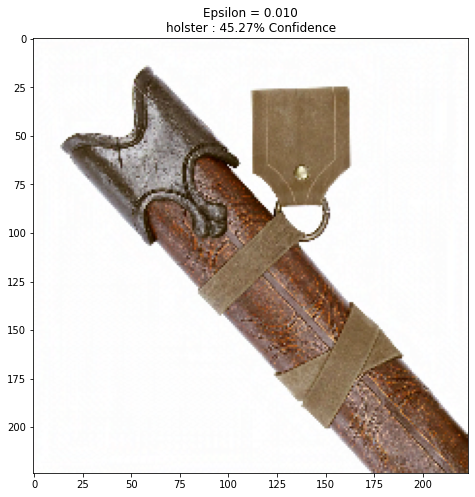

0.01

In [35]:
get_epsilon_and_display(chosen_images[7], chosen_perturbations[7], im_labels[7])

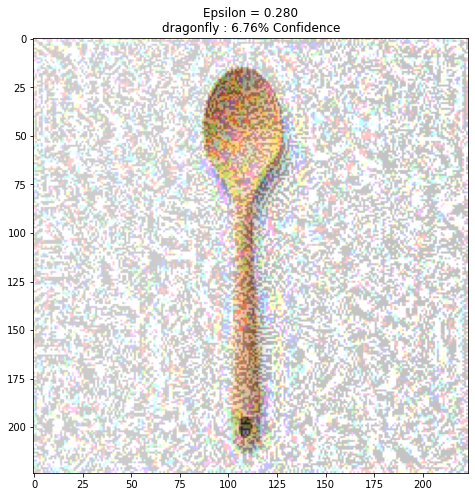

0.2800000000000001

In [36]:
get_epsilon_and_display(chosen_images[8], chosen_perturbations[8], im_labels[8])

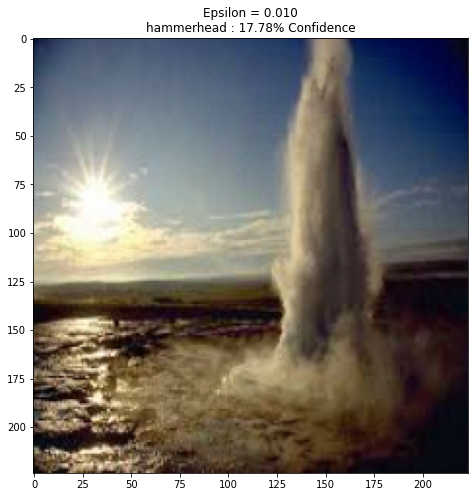

0.01

In [37]:
get_epsilon_and_display(chosen_images[9], chosen_perturbations[9], im_labels[9])

| Image Class | Minimum Epsilon for FGSM |
| ----------- | ----------- |
| Goldfinch | 0.23 |
| Boa Constrictor | 0.01 |
| Scorpion | 0.03 |
| Pizza | 0.01 |
| Buckle | 0.01 |
| Digital clock | 0.44 |
| Dutch oven | 0.01 |
| Scabbard | 0.01 |
| Wooden Spoon | 0.28 |
| Geyser | 0.01 |

As one can see, the FGSM attack is very effective against MobileNet, with only a small amount of
epsilon required to change an image's class most of the time. In 6/10 of the images, only an
epsilon of 0.01 was required. In 3/10, a somewhat larger epsilon was required to change the class,
perhaps because of the clearer backgrounds/more defining features of the object classes present,
meaning the images are more far away from any decision boundaries, meaning even in the
direction of greatest loss, it requires more epsilon to actually cross a decision boundary. Thus,
these perturbed images are slightly more identifiable.


# Task3: Compare the robustness of the considered model with other models. 

Your task here is to compare how this model (MobileNetV2) compares with other popular object detection models. 

Your task is as follows:

* Consider 5 different models (you can consider various RESNET architectures, any models you find interesting).
* Load the pre-trained weights of the model (trained on imagenet). 
* Perform Task2 on all the considered models. 
* Add all the results in the table. Hence the final table you have 6 columns for each model and epsilon values for each of the 10 images for all 6 models. 


What do you observe? Why do you think this is the case? 

Write the Code for the above below. You can also add the table and answer to the question below. 


#Models used:

  ResNet101V2

  ResNet50V2

  ResNet152V2

  NasNetMobile

  DenseNet201

I had issues with VGGNet and so was not able to use it


In [38]:
# Helper function to preprocess the image so that it can be inputted in Mobi
def preprocess_v(image, model_ref):
 image = tf.cast(image, tf.float32)
 image = tf.image.resize(image, (224, 224))
 image = model_ref.preprocess_input(image)
 image = image[None, ...]
 return image
# Helper function to extract labels from probability vector
def get_imagenet_label_v(probs, model_ref):
 # ImageNet labels
 return model_ref.decode_predictions(probs, top=1)[0][0]

In [39]:
models = [
 tf.keras.applications.ResNet101V2(include_top=True,weights='imagenet'),
 tf.keras.applications.ResNet50V2(include_top=True,weights='imagenet'),
 tf.keras.applications.ResNet152V2(include_top=True,weights='imagenet'),
 tf.keras.applications.VGG19(include_top=True,weights='imagenet'),
 tf.keras.applications.DenseNet201(include_top=True,weights='imagenet')
]

82534400/82524592 [==============================] - 2s 0us/step


In [40]:
models[3] = tf.keras.applications.NASNetMobile(include_top=True,weights='imagenet')

24240128/24227760 [==============================] - 0s 0us/step


In [41]:
for i in range(0, 5):
 models[i].trainable = False

In [44]:
model_refs = [
 tf.keras.applications.resnet_v2,
 tf.keras.applications.resnet_v2,
 tf.keras.applications.resnet_v2,
 tf.keras.applications.nasnet,
 tf.keras.applications.densenet
]

In [49]:
loss_object = tf.keras.losses.CategoricalCrossentropy()
def create_adversarial_pattern(input_image, input_label, model):
  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = model(input_image)
    loss = loss_object(input_label, prediction)
  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

In [51]:
# print(tf.keras.applications.resnet101v2.decode_predictions)

In [50]:
model_images = []
model_images_probs = []
chosen_indexes = [11, 61, 71, 963, 464, 530, 544, 777, 910, 974]
for j in range(0, 5):
  model = models[j]
  model_ref = model_refs[j]
  images = []
  probs = []
  for i in range(0, 10):
    image_raw = tf.io.read_file('image'+ str(i) + '.jpg')
    image = tf.image.decode_image(image_raw)
    image = preprocess_v(image, model_ref)
    images.append(image)
    image_probs = model.predict(image)
    probs.append(image_probs)
  # display_images(image, "")
  model_images.append(images)
  model_images_probs.append(probs)

In [52]:
model_perturbations = []
for j in range(0, 5):
  perturbs = []
  for i in range(0, 10):
    label = tf.one_hot(chosen_indexes[i], model_images_probs[j][i].shape[-1])
    label = tf.reshape(label, (1, model_images_probs[j][i].shape[-1]))
    perturbations = create_adversarial_pattern(model_images[j][i], label, models[j])
    # plt.imshow(perturbations[0] * 0.5 + 0.5); # To change [-1, 1] to
    perturbs.append(perturbations)
  model_perturbations.append(perturbs)

In [53]:
im_labels = [
"goldfinch",
"boa_constrictor",
"scorpion",
"pizza",
"buckle",
"digital_clock",
"Dutch_oven",
"scabbard",
"wooden_spoon",
"geyser"
]
def get_lowest_epsilon_and_display(image, pert, actual_label, model, model_ref):
  eps = 0
  adv_x = image + eps*pert
  adv_x = tf.clip_by_value(adv_x, -1, 1)
  _, label, confidence = get_imagenet_label_v(model.predict(adv_x), model_ref)
  while label == actual_label:
    eps = eps + 0.01
    adv_x = image + eps*pert
    adv_x = tf.clip_by_value(adv_x, -1, 1)
    _, label, confidence = get_imagenet_label_v(model.predict(adv_x), model_ref)
  # print(eps)
  # print(label)
  # print(actual_label)
  plt.figure()
  plt.imshow(adv_x[0]*0.5+0.5)
  plt.title('Epsilon = {:0.3f}\n{} : {:.2f}% Confidence'.format(eps, label,confidence*100))
  plt.show()
  return eps

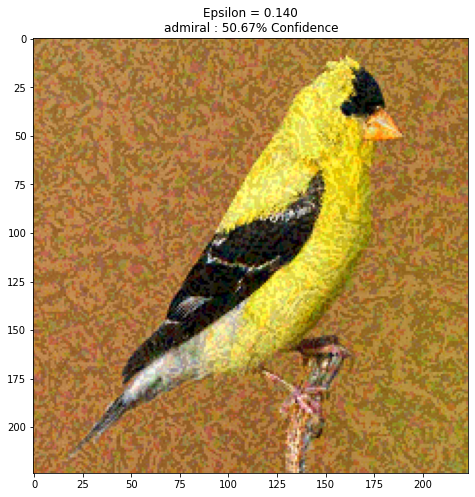

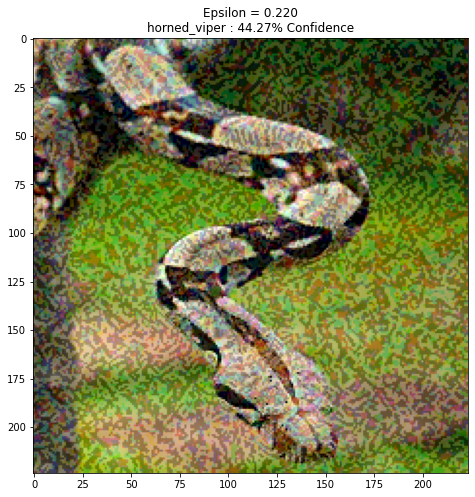

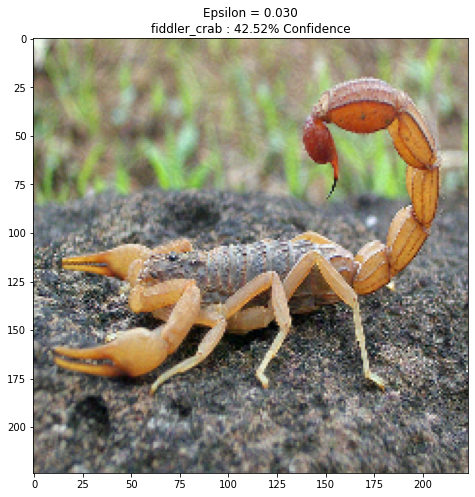

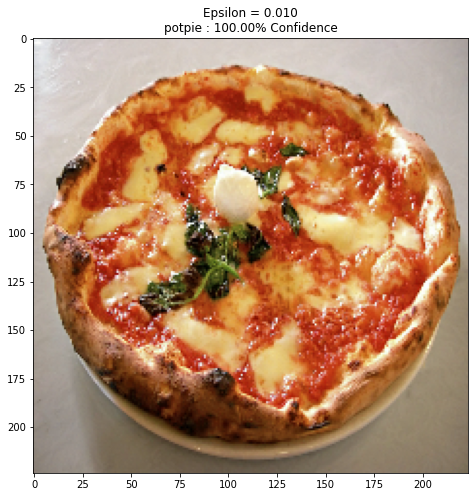

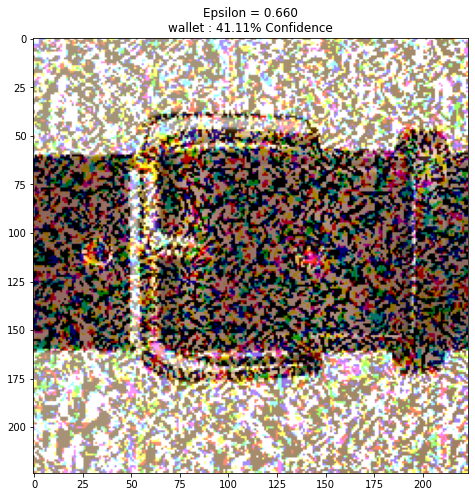

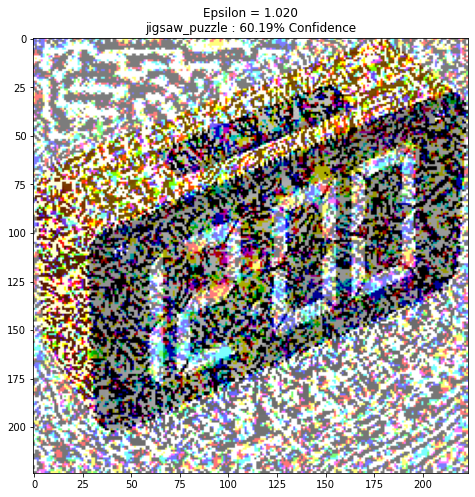

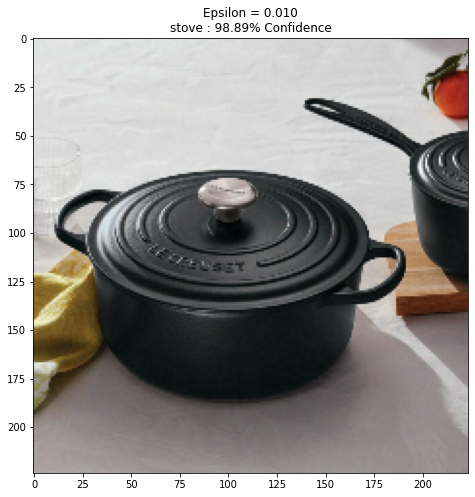

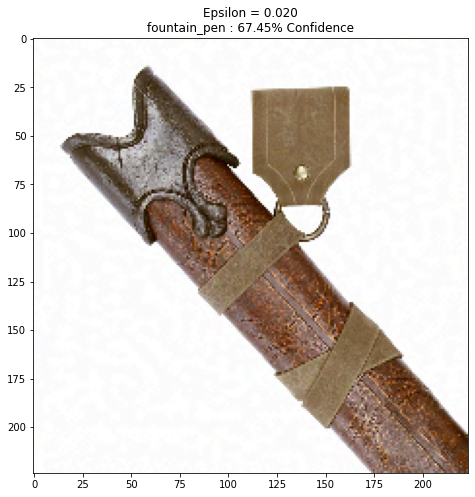

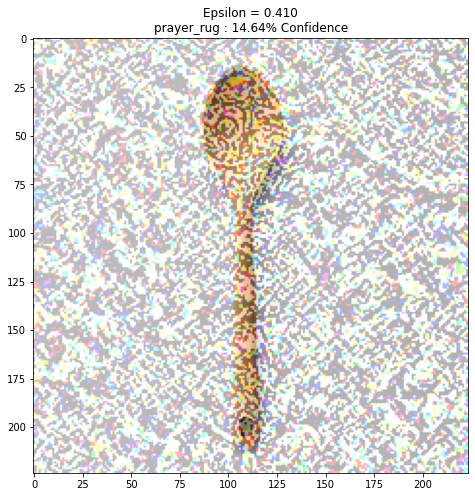

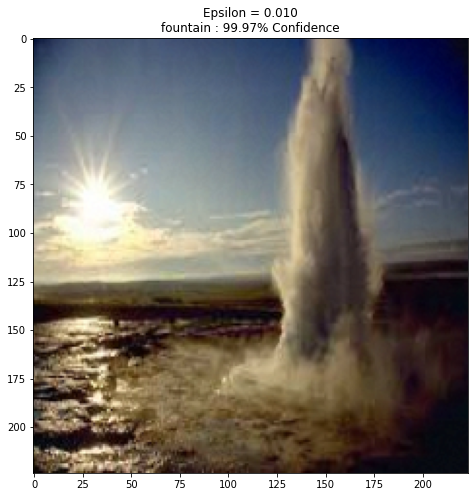

In [54]:
j = 0
model_epsilons = []
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(model_images[j][i], model_perturbations[j][i], im_labels[i], models[j], model_refs[j]))
model_epsilons.append(epsilons)

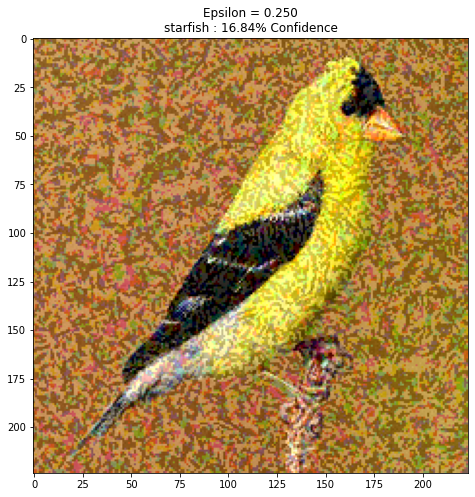

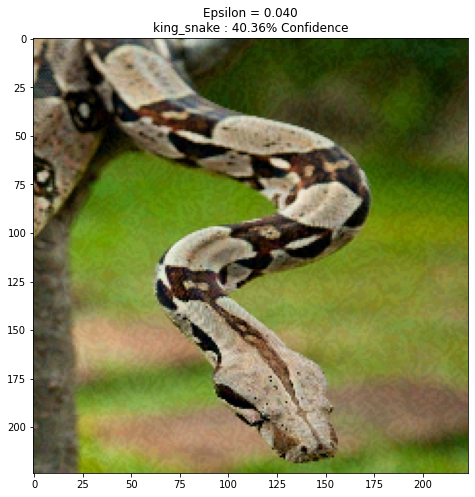

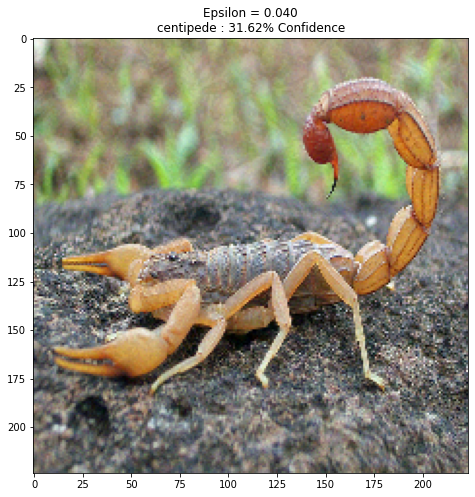

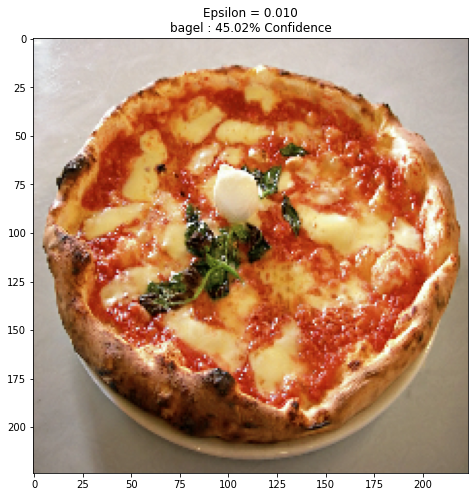

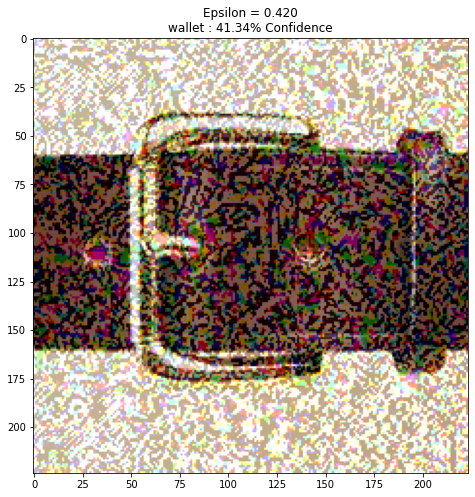

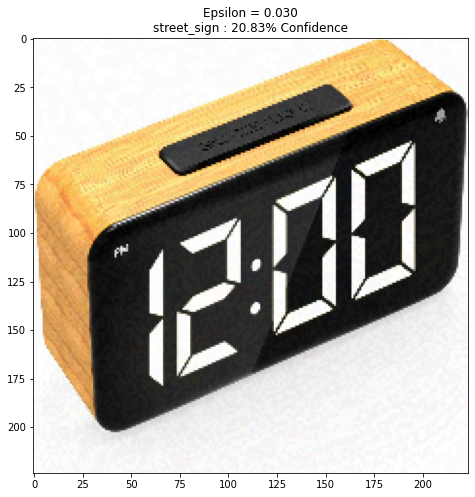

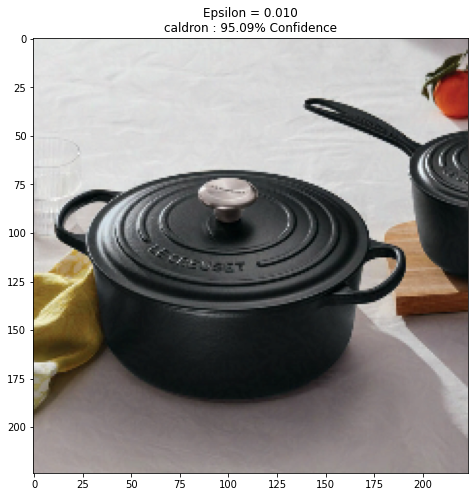

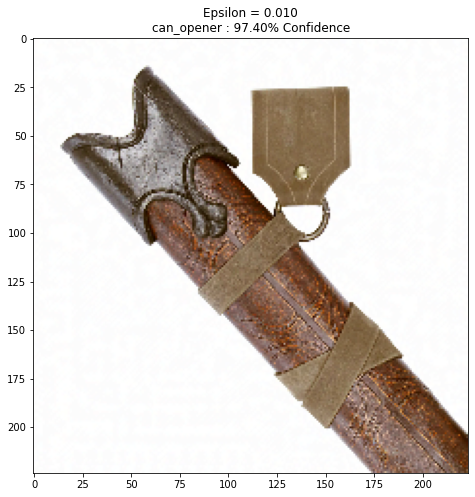

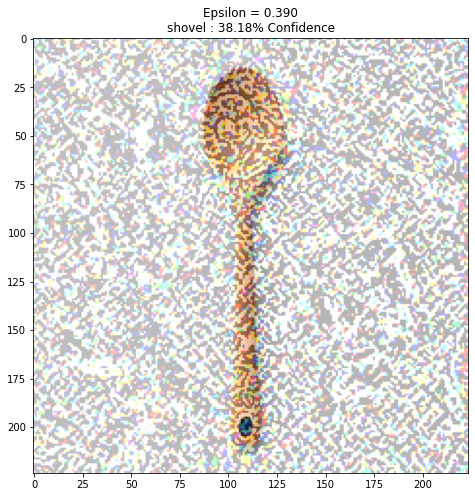

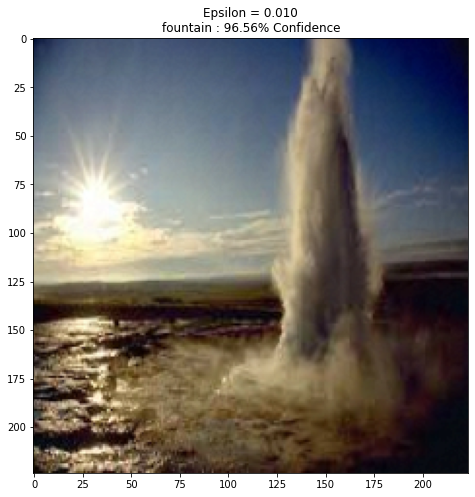

In [55]:
j = 1
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(model_images[j][i], model_perturbations[j][i], im_labels[i], models[j], model_refs[j]))
model_epsilons.append(epsilons)

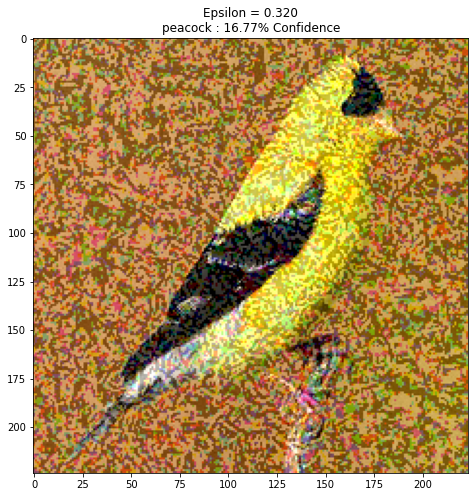

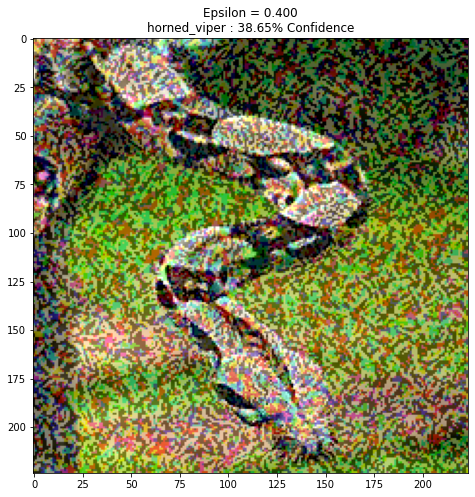

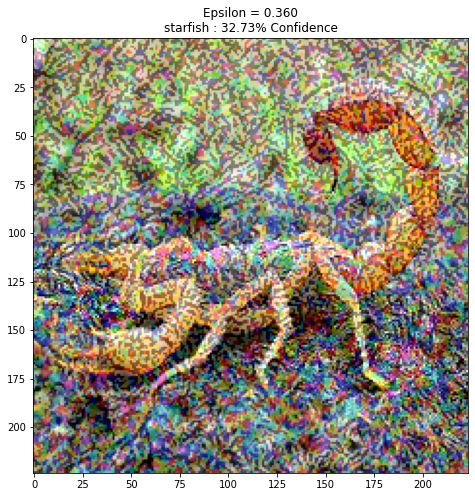

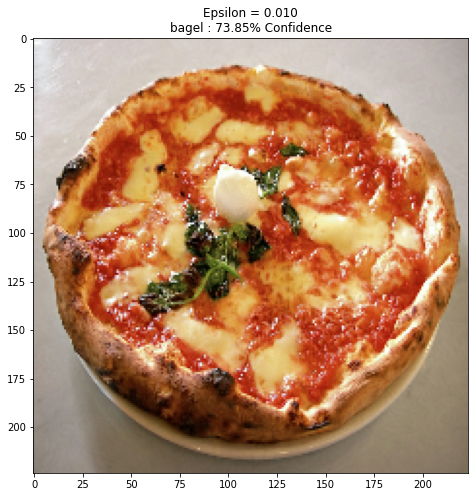

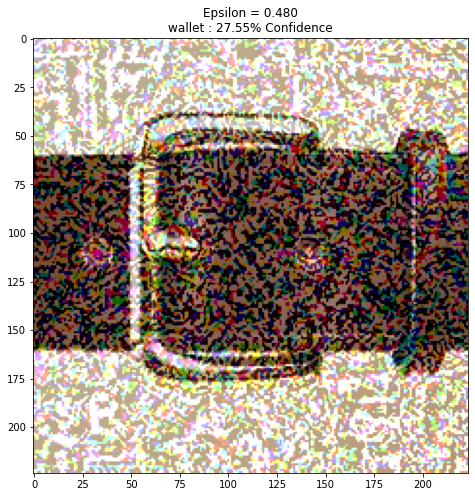

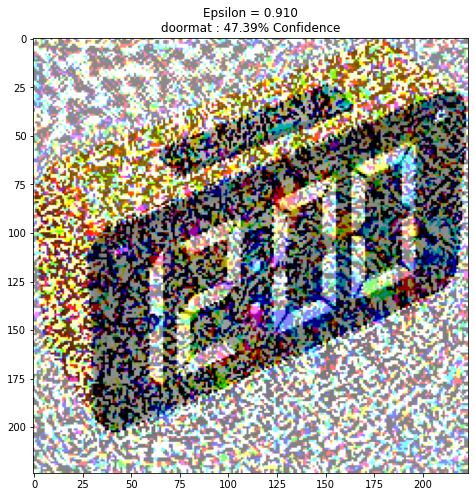

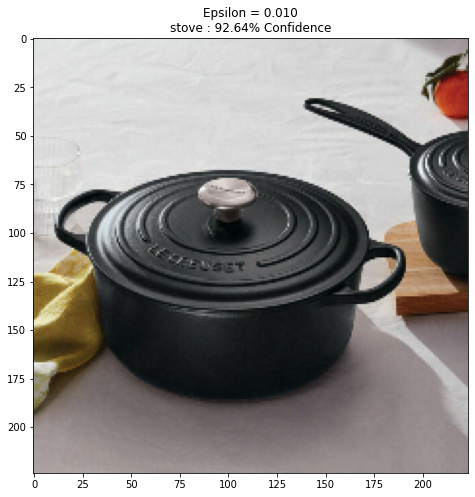

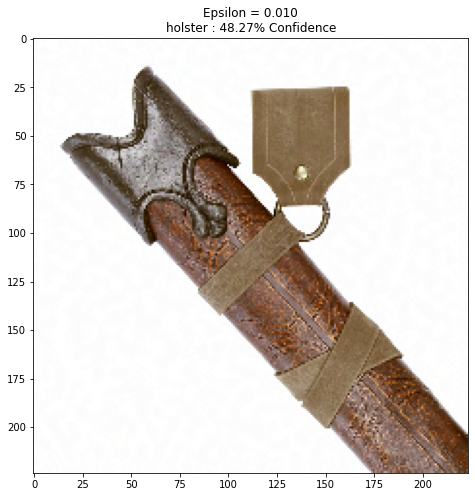

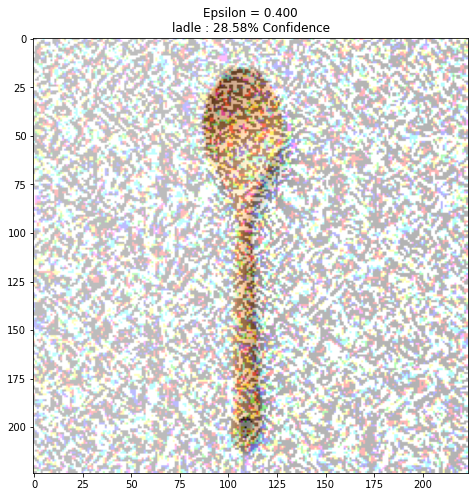

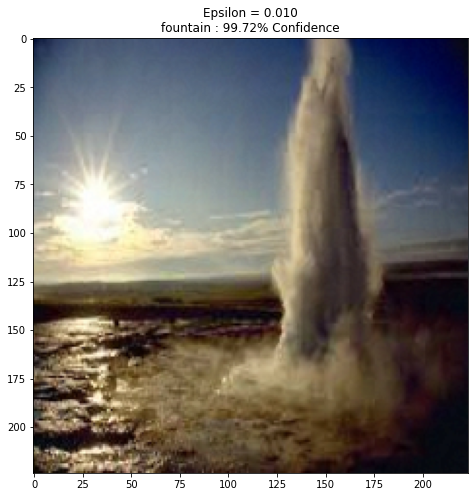

In [56]:
j = 2
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(model_images[j][i], model_perturbations[j][i], im_labels[i], models[j], model_refs[j]))
model_epsilons.append(epsilons)

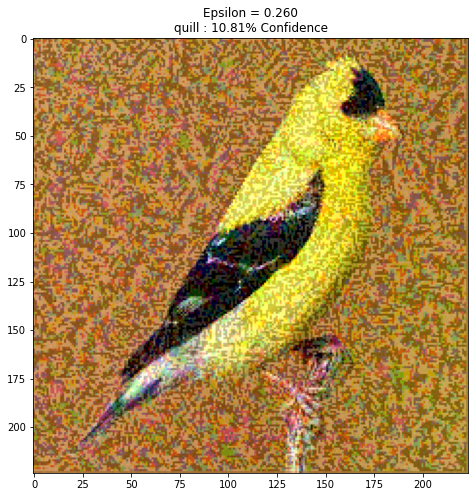

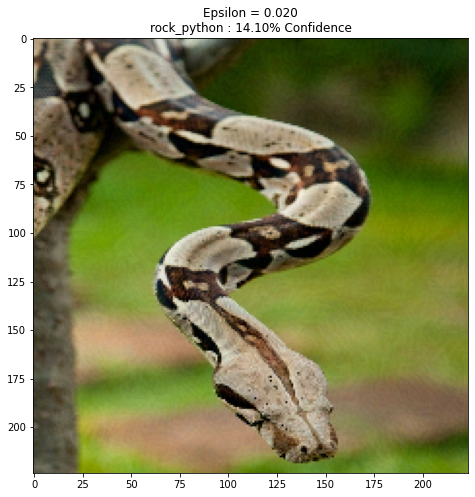

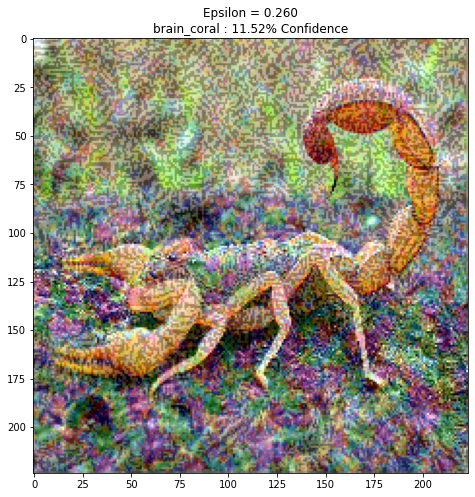

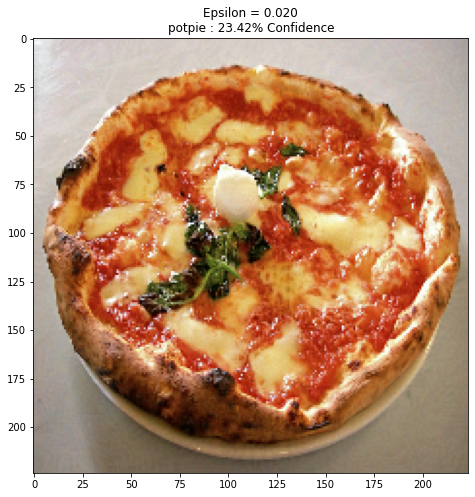

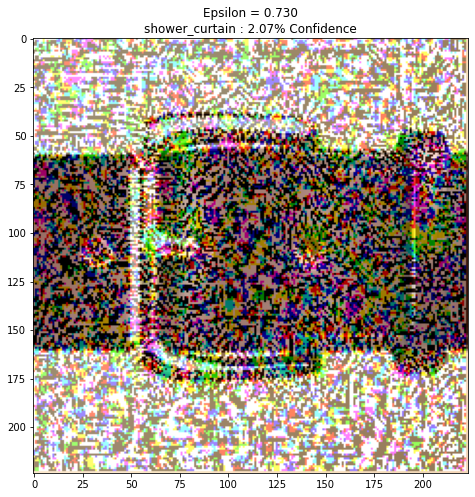

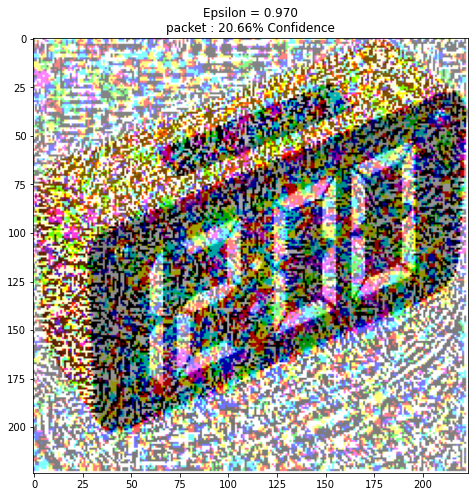

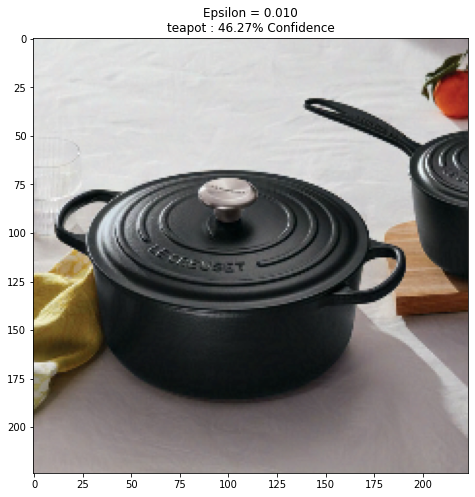

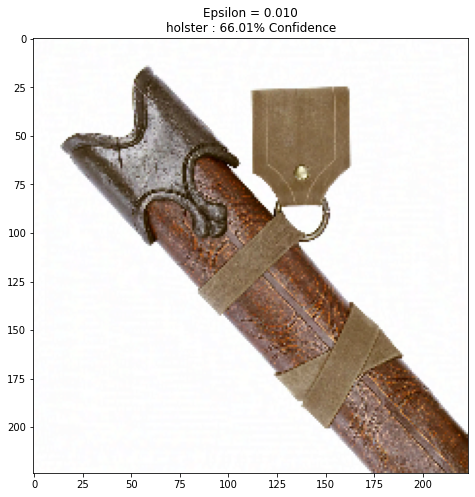

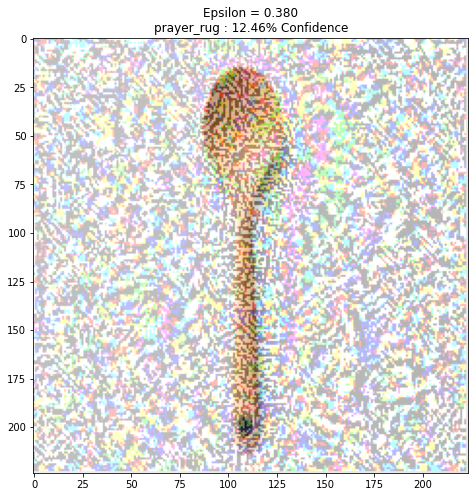

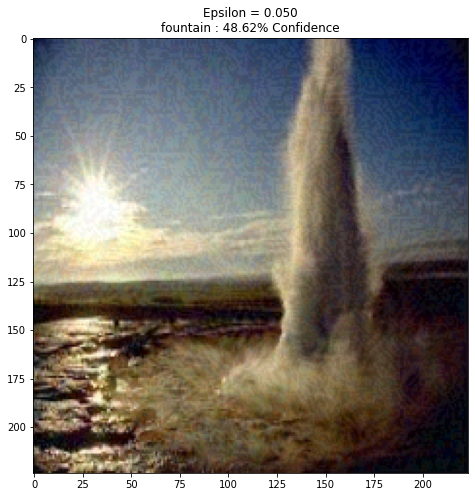

In [57]:
j = 3
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(model_images[j][i], model_perturbations[j][i], im_labels[i], models[j], model_refs[j]))
model_epsilons.append(epsilons)

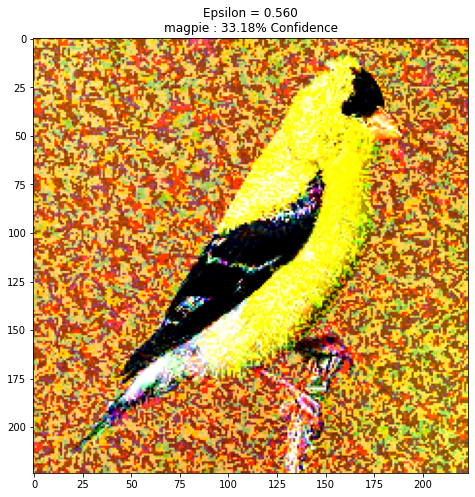

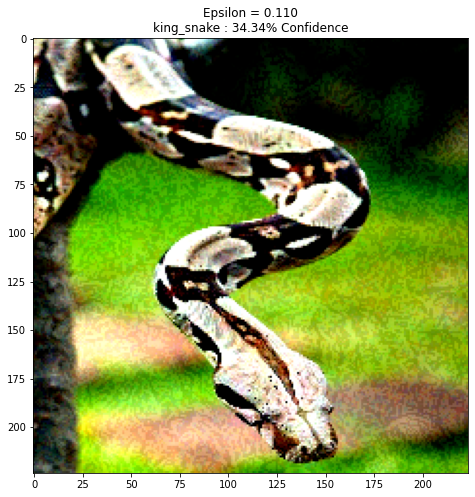

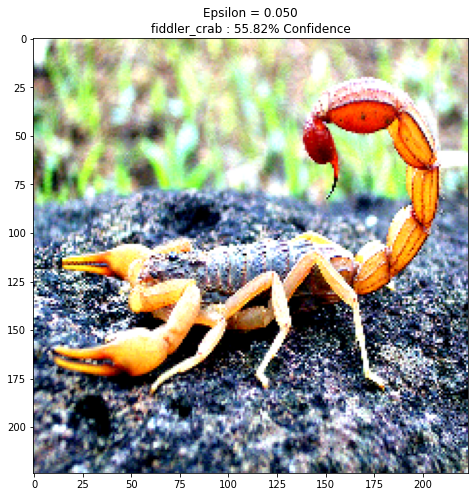

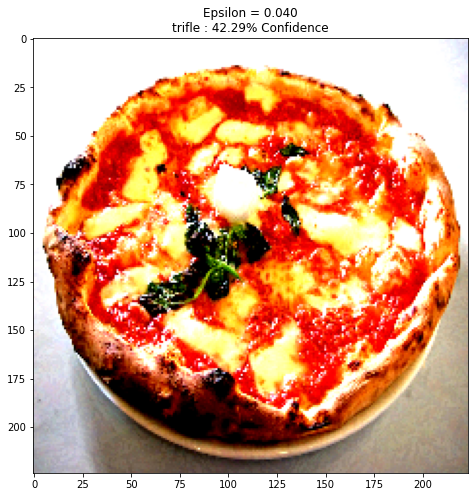

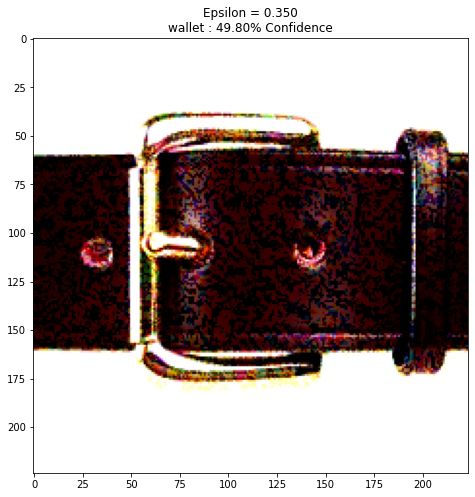

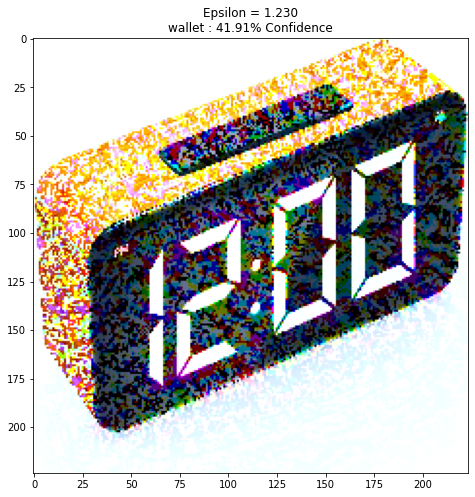

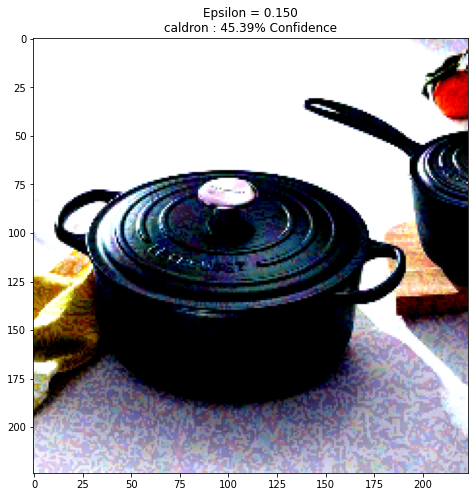

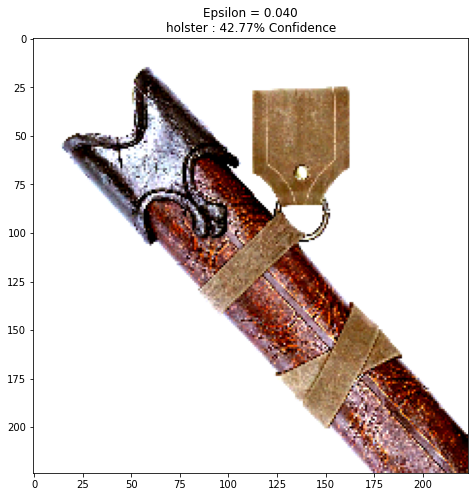

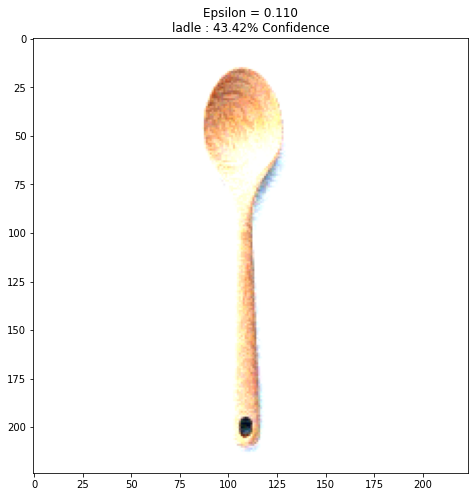

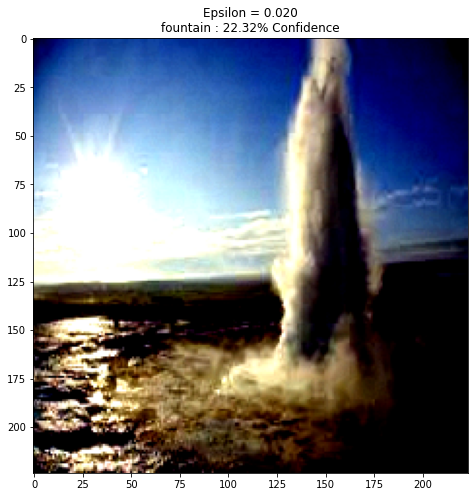

In [58]:
j = 4
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(model_images[j][i], model_perturbations[j][i], im_labels[i], models[j], model_refs[j]))
model_epsilons.append(epsilons)

In [59]:
print(model_epsilons)


[[0.13999999999999999, 0.22000000000000006, 0.03, 0.01, 0.6600000000000004, 1.0200000000000007, 0.01, 0.02, 0.4100000000000002, 0.01], [0.25000000000000006, 0.04, 0.04, 0.01, 0.4200000000000002, 0.03, 0.01, 0.01, 0.3900000000000002, 0.01], [0.3200000000000001, 0.4000000000000002, 0.36000000000000015, 0.01, 0.48000000000000026, 0.9100000000000006, 0.01, 0.01, 0.4000000000000002, 0.01], [0.26000000000000006, 0.02, 0.26000000000000006, 0.02, 0.7300000000000004, 0.9700000000000006, 0.01, 0.01, 0.38000000000000017, 0.05], [0.5600000000000003, 0.10999999999999999, 0.05, 0.04, 0.35000000000000014, 1.2300000000000009, 0.15, 0.04, 0.10999999999999999, 0.02]]


In [61]:
mobileneteps = [0.23,0.01,0.03,0.01,0.01,0.44,0.01,0.01,0.28,0.01]
print(np.mean(model_epsilons, axis=1))
print(np.mean(mobileneteps))

[0.253 0.121 0.291 0.271 0.266]
0.10400000000000001


In general, the ResNet, NASNet and DenseNet models were more robust to the FGSM attack than
MobileNet. This is shown by the fact that the average required epsilon to change the class of an
image was higher for all the tested models compared to MobileNet. This is probably the case
because of the higher complexity of the other models as compared to MobileNet. As one can see
in the code above, the other models have a lot more weights (on the order of 10^8 as opposed to
MobileNet's approximately 10^4 weights). Thus, because the models have more complex
functions, their loss functions are also more complex, making it harder to find and navigate to a
decision boundary for a given image.




| Image Class | MobileNet | ResNet101V2 | ResNet50V2 | ResNet152V2 | NasNetMobile | DenseNet201 |
| ----------- | ----------- | ----------- | ----------- | ----------- | ----------- | ----------- |
| Goldfinch       | 0.23 | 0.14 | 0.25 | 0.32 | 0.26 | 0.56 |
| Boa Constrictor | 0.01 | 0.22 | 0.04 | 0.40 | 0.02 | 0.11 |
| Scorpion        | 0.03 | 0.03 | 0.04 | 0.36 | 0.26 | 0.05
| Pizza           | 0.01 | 0.01 | 0.01 | 0.01 | 0.02 | 0.04
| Buckle          | 0.01 | 0.66 | 0.42 | 0.48 | 0.73 | 0.35
| Digital clock   | 0.44 | 1.02 | 0.03 | 0.91 | 0.97 | 1.23
| Dutch oven      | 0.01 | 0.01 | 0.01 | 0.01 | 0.01 | 0.15
| Scabbard        | 0.01 | 0.02 | 0.01 | 0.01 | 0.01 | 0.04
| Wooden Spoon    | 0.28 | 0.41 | 0.39 | 0.40 | 0.38 | 0.11
| Geyser          | 0.01 | 0.01 | 0.01 | 0.01 | 0.05 | 0.02


# BONUS: Can you provide a better attack?

Can you design a better attack that lowers the epsilon required for the images?

Task:

* Design another attack. 
* Compare the epsilon values on 10 images. 
* Does it perform better than the FGSM attack? That is, does it have lower epsilon values?

Write the code and provide your answers below. 

In [65]:
def create_adversarial_another(input_image, input_label, model):
  #Add random noise to the input image (RAND-FGSM)

  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = model(input_image + 0.001 * np.random.normal(size=(1, 224,224, 3)))
    loss = loss_object(input_label, prediction)
  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

In [66]:
probs = []
images = []
model = models[3]
model_ref = model_refs[3]
for i in range(0, 10):
  image_raw = tf.io.read_file('image'+ str(i) + '.jpg')
  image = tf.image.decode_image(image_raw)
  image = preprocess_v(image, model_ref)
  images.append(image)
  image_probs = model.predict(image)
  probs.append(image_probs)
  # display_images(image, "")
  model_images.append(images)
  model_images_probs.append(probs)

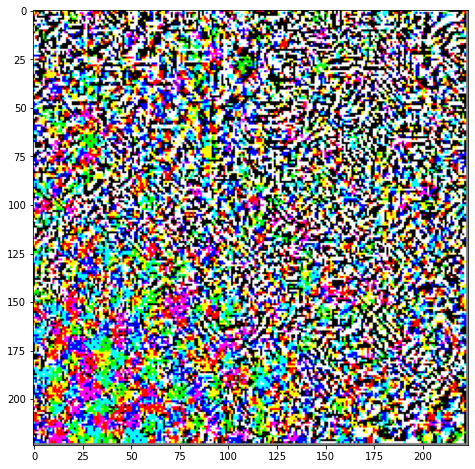

In [67]:
perbs = []

for i in range(0, 10):
  label = tf.one_hot(chosen_indexes[i], probs[i].shape[-1])
  label = tf.reshape(label, (1, probs[i].shape[-1]))

  perturbations = create_adversarial_another(images[i], label, model)
  plt.imshow(perturbations[0] * 0.5 + 0.5); # To change [-1, 1] to [0,1]
  perbs.append(perturbations)

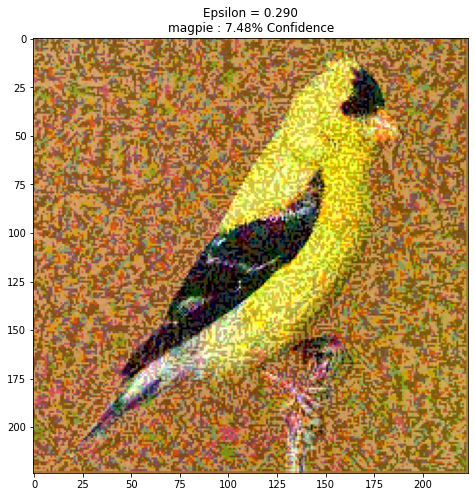

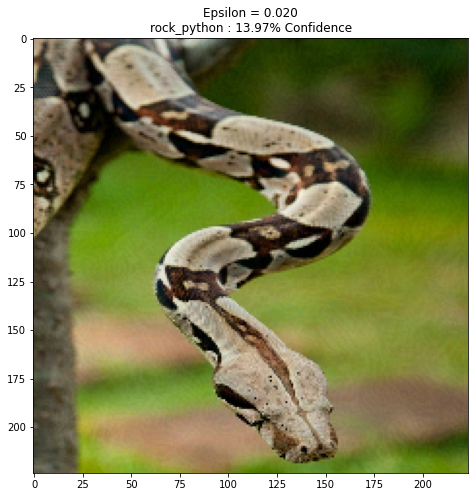

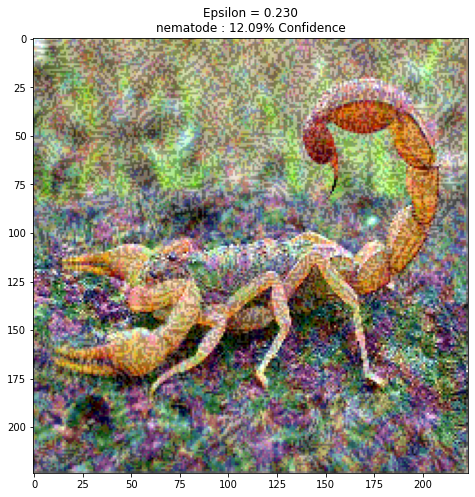

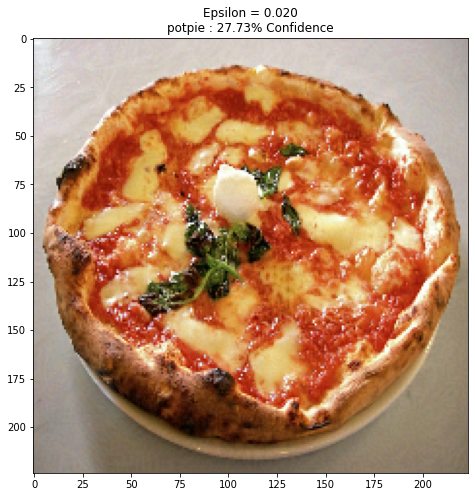

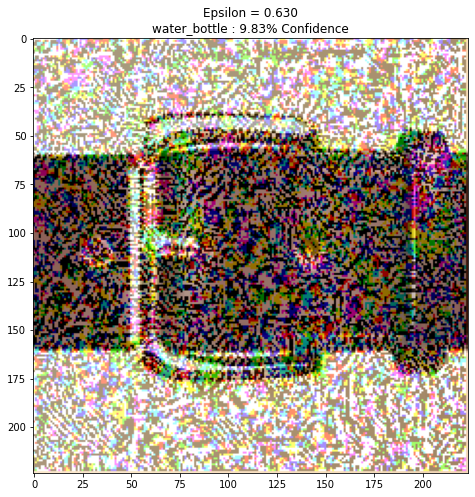

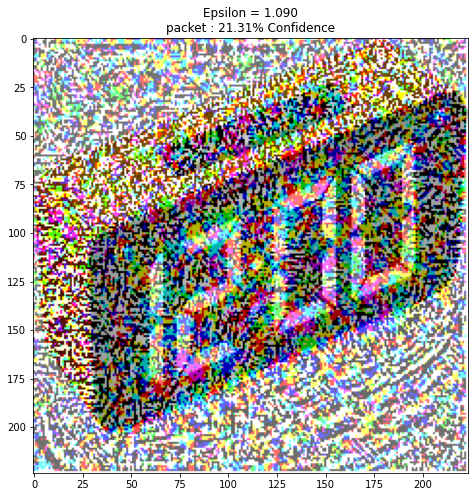

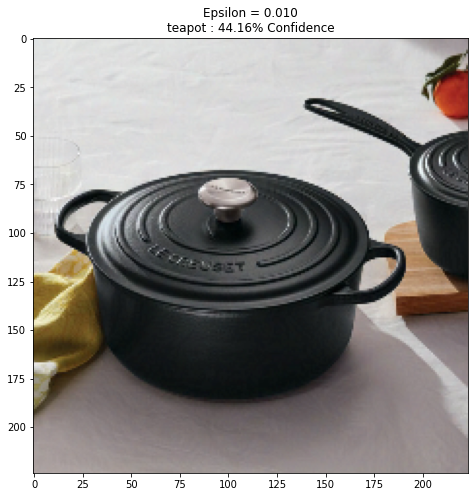

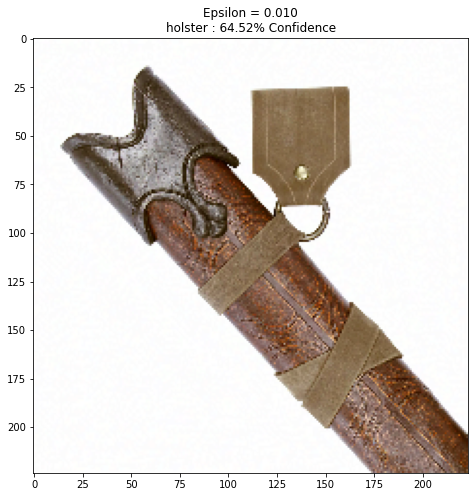

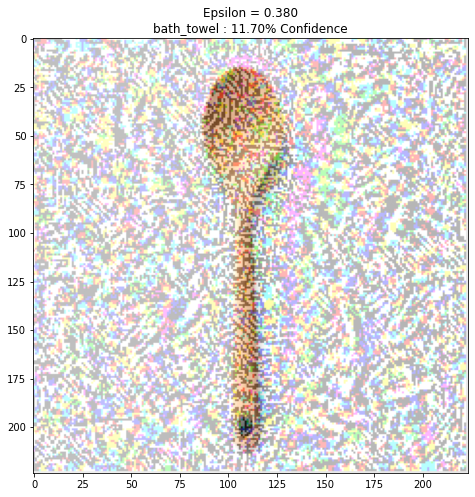

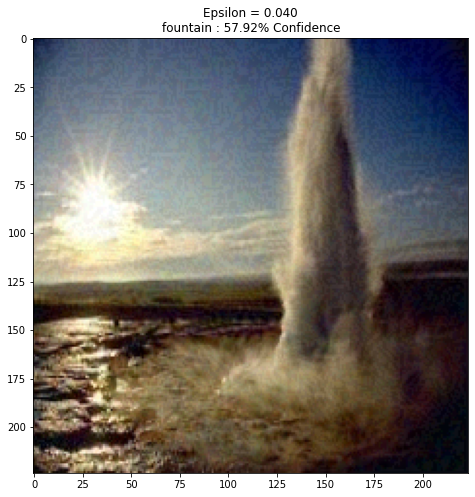

In [68]:
epsilons = []
for i in range(0, 10):
 epsilons.append(get_lowest_epsilon_and_display(images[i], perbs[i], im_labels[i], model, model_ref))

In [69]:
print(epsilons)
print(np.mean(epsilons))

[0.2900000000000001, 0.02, 0.23000000000000007, 0.02, 0.6300000000000003, 1.0900000000000007, 0.01, 0.01, 0.38000000000000017, 0.04]
0.27200000000000013


I attempted to add random variation when updating the adversarial samples-- this is to help mask
the gradient and overcome any adversarial training the model might have. We end up with worse
performance, as the required epsilons are overall higher. This is because while adding the random
mask might help with any existing robustness measures, it actively harms our attempts to get to
the direction of the optimal loss to get to the nearest decision boundary. Thus, it takes more
epsilon to actually affect the image.
